In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
from PIL import Image
from google.colab import files
import requests

In [ ]:
!pip install opencv-python-headless

## Leer Archivos

Saving 1010.png to 1010.png
Saving 1012.png to 1012.png
Saving 1014.png to 1014.png
Saving 1021.png to 1021.png
Se cargaron 4 imágenes.


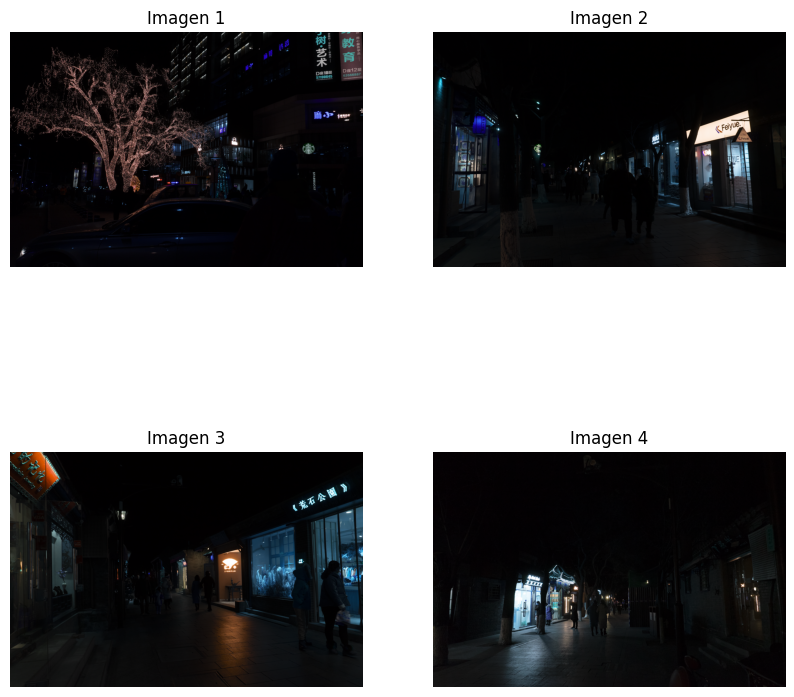

In [ ]:
# Abrimos la imagen con openCV: Se trata de una matriz de numpy
# img = cv2.imread('../images/bananos.jpg')

# Subir múltiples imágenes
uploaded = files.upload()  # Permite cargar varias imágenes a la vez
image_paths = list(uploaded.keys())  # Obtiene las rutas de los archivos cargados

# Leer y almacenar las imágenes en una lista
images = []  # Lista para guardar las imágenes
plt.figure(figsize=(10, 10))
i = 0
for image_path in image_paths[:4]:  # Limitar a las primeras 4 imágenes
    img = cv2.imread(image_path)  # Leer la imagen con OpenCV
    if img is not None:
        images.append(img)  # Agregar la imagen a la lista
        plt.subplot(2, 2, i + 1)  # Cuadrícula 2x2
        plt.imshow(img)
        plt.title(f"Imagen {i + 1}")  # Título para cada imagen
        plt.axis("off")  # Eliminar los ejes para una mejor visualización
        i = i + 1
    else:
        print(f"No se pudo leer la imagen: {image_path}")

# Verificar las imágenes cargadas
print(f"Se cargaron {len(images)} imágenes.")

In [ ]:
# Resolución 900x1200 píxeles y 3 valores por píxel o canal (RGB)
images[0].shape

(720, 1080, 3)

In [ ]:
images[0][500,500]
#FORMATO BGR

array([1, 1, 2], dtype=uint8)

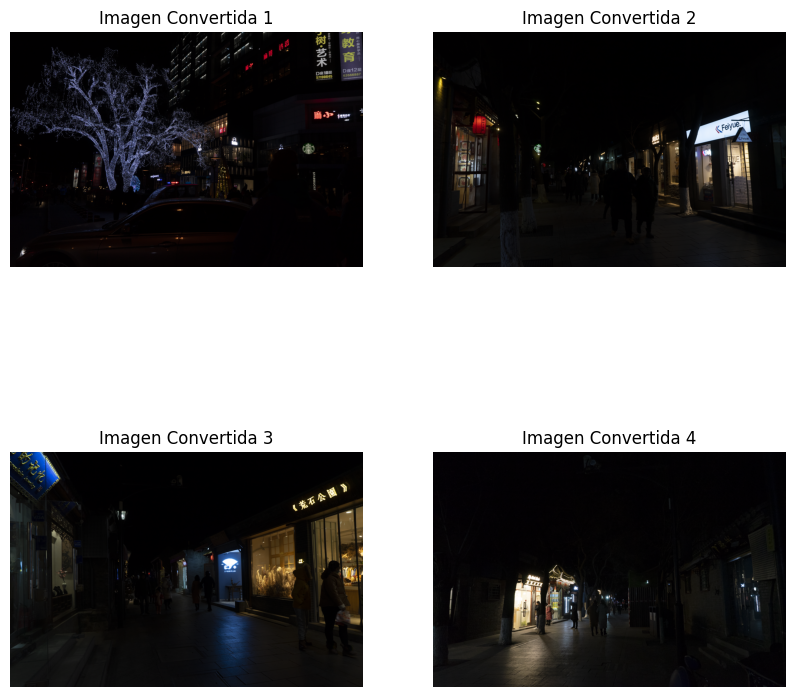

In [ ]:
# Convertir imágenes de BGR a RGB
images_rgb = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images if img is not None]

# Visualizar las imágenes en formato RGB
plt.figure(figsize=(10, 10))
for i, img_rgb in enumerate(images_rgb[:4]):  # Limitar a las primeras 4 imágenes
    plt.subplot(2, 2, i + 1)  # Cuadrícula 2x2
    plt.imshow(img_rgb)  # Mostrar en RGB
    plt.title(f"Imagen Convertida {i + 1}")  # Título para cada imagen
    plt.axis("off")  # Eliminar los ejes para una mejor visualización

plt.show()

### Escala de Grises
- Es más sencillo trabajar con 1 valor por píxel que 3 valores por píxel
- Obtener medidas sobre la intensidad en la imagen

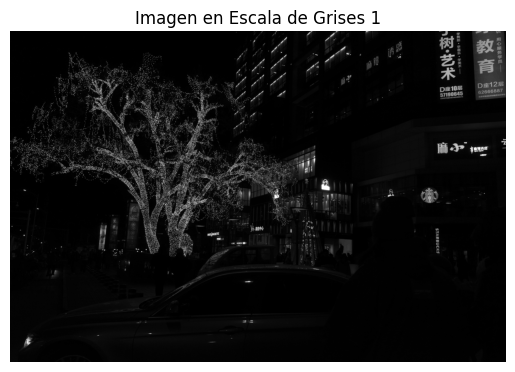

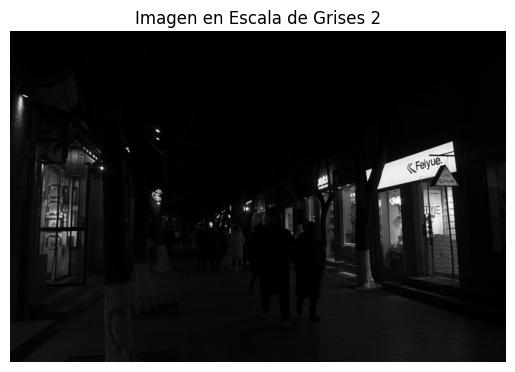

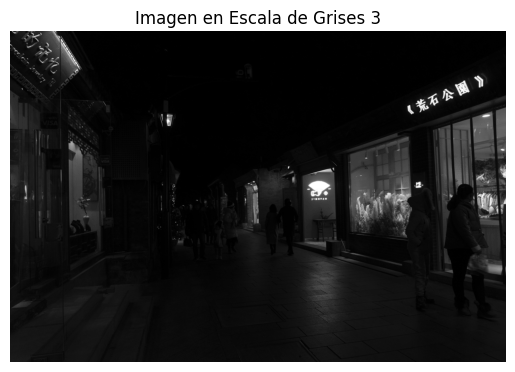

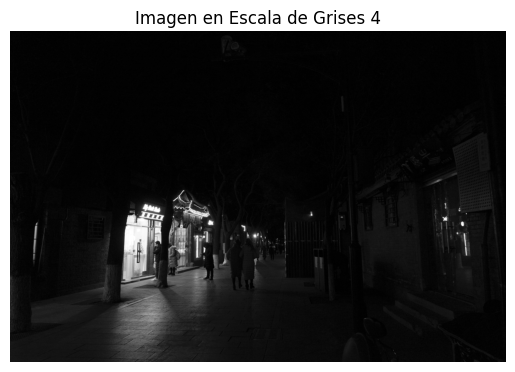

In [ ]:
# Pasamos a Escala de Grises (Un solo valor por píxel donde 0 es negro y 255 blanco)
#gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#print(gray_img[600,500]) # Imprimimos un Píxel Gray Scale
#plt.imshow(gray_img, cmap='gray');

# Alternativa: Leer la imagen en escala de grises
# gray_img = cv2.imread('../images/bananos.jpg', cv2.IMREAD_GRAYSCALE)



# Transformar las imágenes a escala de grises
gray_images = []  # Lista para guardar imágenes en escala de grises
for img in images:  # Iterar sobre las imágenes cargadas
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir a escala de grises
    gray_images.append(gray_img)  # Agregar la imagen en escala de grises a la lista

# Mostrar las imágenes en escala de grises
for i, gray_img in enumerate(gray_images):
    plt.figure()
    plt.imshow(gray_img, cmap='gray')  # Mostrar en escala de grises
    plt.title(f'Imagen en Escala de Grises {i+1}')
    plt.axis('off')
    plt.show()

## Umbralización: Imagen Binaria
- Se usa para resaltar objetos de interés
- Obtener medidas sobre la forma de los objetos

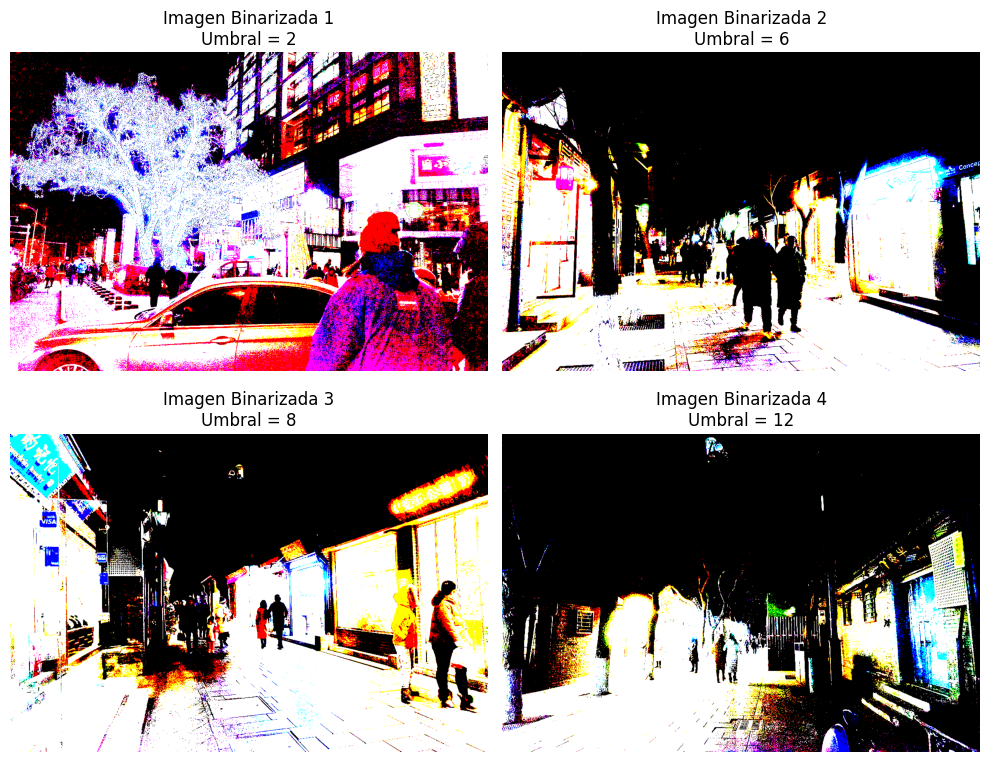

In [ ]:
# Umbrales individuales para cada imagen
umbral_values = [2, 6, 8, 12]  # Especifica el umbral para cada imagen

# Lista para almacenar las imágenes binarizadas
binary_images = []

# Aplicar umbralización con diferentes valores a cada imagen
for gray_img, umbral in zip(images_rgb, umbral_values):  # Iterar sobre imágenes y umbrales
    binaria = np.uint8((gray_img > umbral) * 255)  # Umbralización
    binary_images.append(binaria)  # Guardar la imagen binarizada

# Mostrar las imágenes binarizadas 2 a 2
fig, axes = plt.subplots(2, 2, figsize=(10, 8))  # Crear una cuadrícula 2x2
for i, ax in enumerate(axes.flat):  # Iterar sobre los ejes y las imágenes
    if i < len(binary_images):  # Asegurarse de que hay imágenes para mostrar
        ax.imshow(binary_images[i], cmap='gray')  # Mostrar imagen binarizada
        ax.set_title(f'Imagen Binarizada {i+1}\nUmbral = {umbral_values[i]}')
        ax.axis('off')
    else:
        ax.axis('off')  # Apagar ejes vacíos si hay menos de 4 imágenes

plt.tight_layout()
plt.show()



### ¿Puedo fijar un valor óptimo visual para la umbralización?

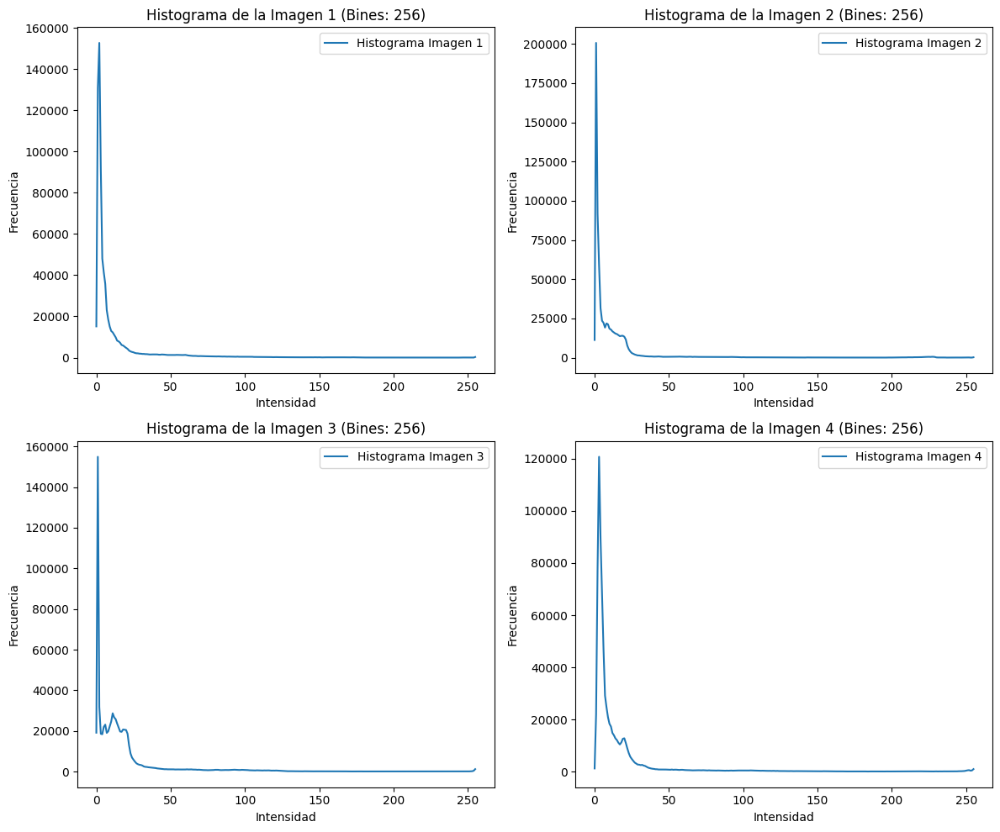

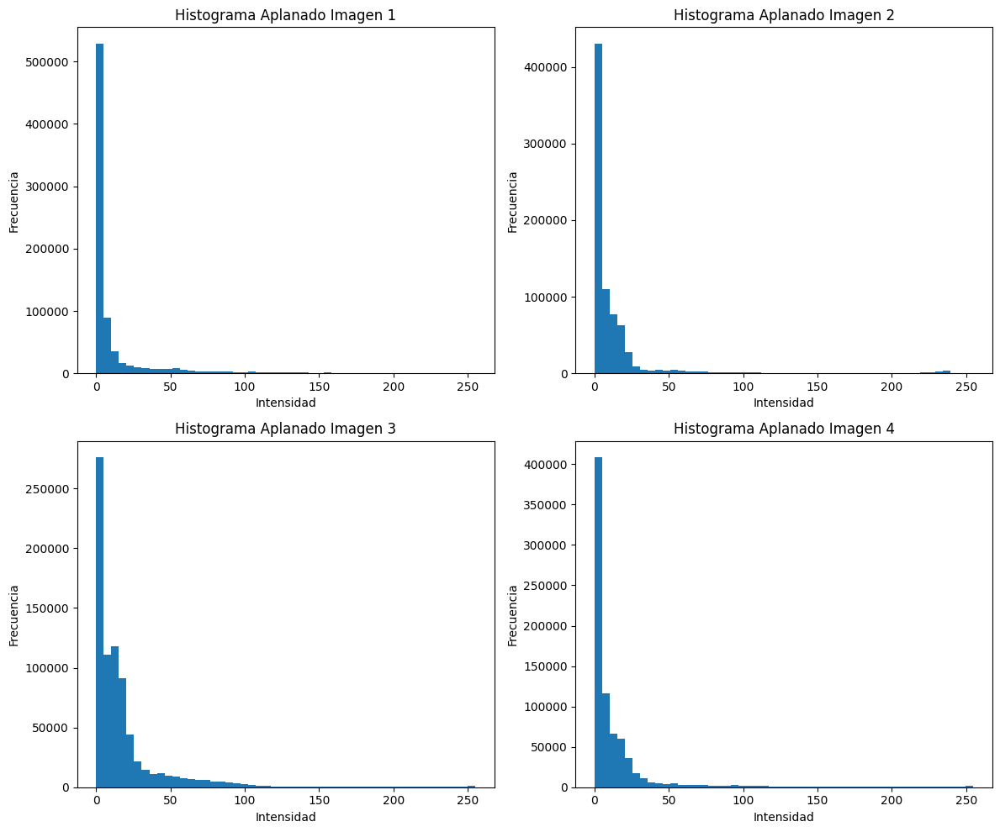

In [ ]:
log_scale = False  # Establecer si deseas usar escala logarítmica para el histograma
bins = 256  # Número de bines para el histograma

# Configurar la cuadrícula 2x2 para los histogramas
fig, axes = plt.subplots(2, 2, figsize=(12, 10))  # Crear una cuadrícula 2x2 para los histogramas de intensidad

# Calcular y mostrar histogramas para las 4 imágenes en escala de grises
for i, (gray_img, ax) in enumerate(zip(images_rgb, axes.flat)):  # Iterar sobre cada imagen y su eje correspondiente
    # Calcular el histograma
    hist = cv2.calcHist([gray_img], [0], None, [bins], [0, 256])

    # Configurar el gráfico con escala logarítmica en el eje Y (si es necesario)
    ax.plot(hist, label=f'Histograma Imagen {i+1}')
    ax.set_title(f'Histograma de la Imagen {i+1} (Bines: {bins})')
    ax.set_xlabel('Intensidad')

    if log_scale:
        ax.set_yscale('log')  # Escala logarítmica
        ax.set_ylabel('Frecuencia (log)')
    else:
        ax.set_ylabel('Frecuencia')

    ax.legend()

plt.tight_layout()
plt.show()

# Mostrar los histogramas aplanados en una cuadrícula 2x2
fig, axes = plt.subplots(2, 2, figsize=(12, 10))  # Crear una cuadrícula 2x2 para los histogramas aplanados

for i, (gray_img, ax) in enumerate(zip(gray_images, axes.flat)):  # Iterar sobre cada imagen y su eje correspondiente
    # Aplanamos la matriz de la imagen
    vector = gray_img.flatten()

    # Histograma aplanado con un número menor de bines
    ax.hist(vector, bins=50)
    ax.set_title(f'Histograma Aplanado Imagen {i+1}')
    ax.set_xlabel('Intensidad')
    ax.set_ylabel('Frecuencia')

plt.tight_layout()
plt.show()


## Negativo

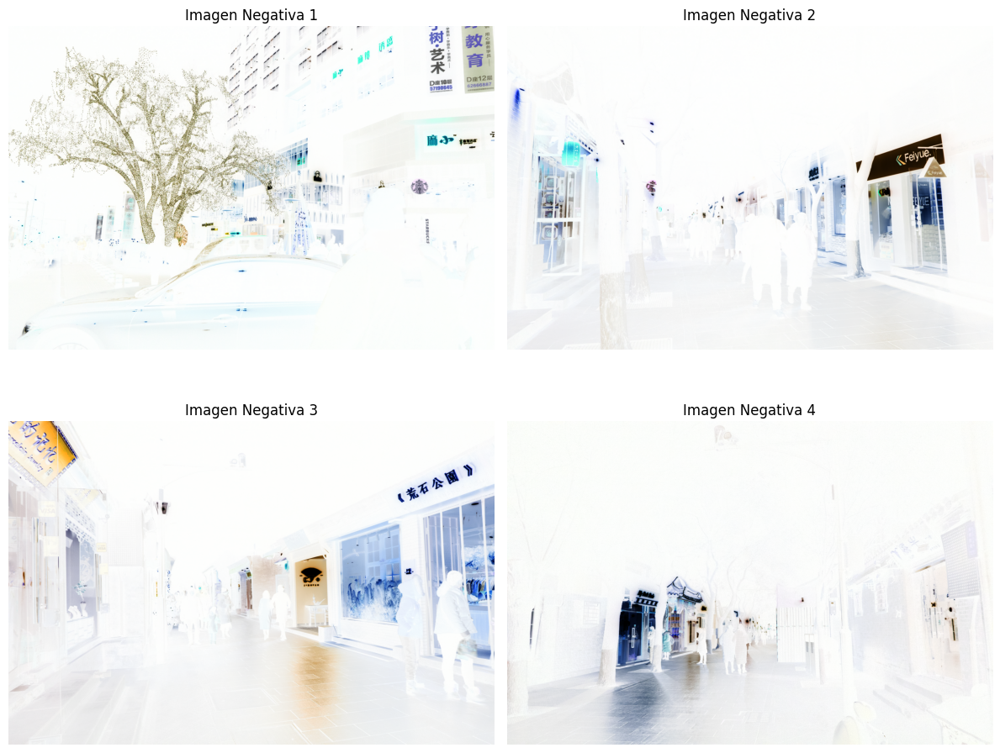

In [ ]:
# Generar el negativo para las 4 imágenes en escala de grises
negative_images = []  # Lista para almacenar las imágenes negativas

for gray_img in images_rgb:  # Iterar sobre las imágenes en escala de grises
    imagen_negativa = np.max(gray_img) - gray_img  # Generar el negativo
    negative_images.append(imagen_negativa)  # Guardar la imagen negativa

# Mostrar las imágenes negativas en una cuadrícula 2x2
fig, axes = plt.subplots(2, 2, figsize=(12, 10))  # Crear una cuadrícula 2x2 para las imágenes negativas

for i, (imagen_negativa, ax) in enumerate(zip(negative_images, axes.flat)):  # Iterar sobre imágenes y ejes
    ax.imshow(imagen_negativa, cmap='gray')  # Mostrar imagen negativa
    ax.set_title(f'Imagen Negativa {i+1}')
    ax.axis('off')  # Apagar los ejes

plt.tight_layout()
plt.show()

## Transformaciones Logarítmicas

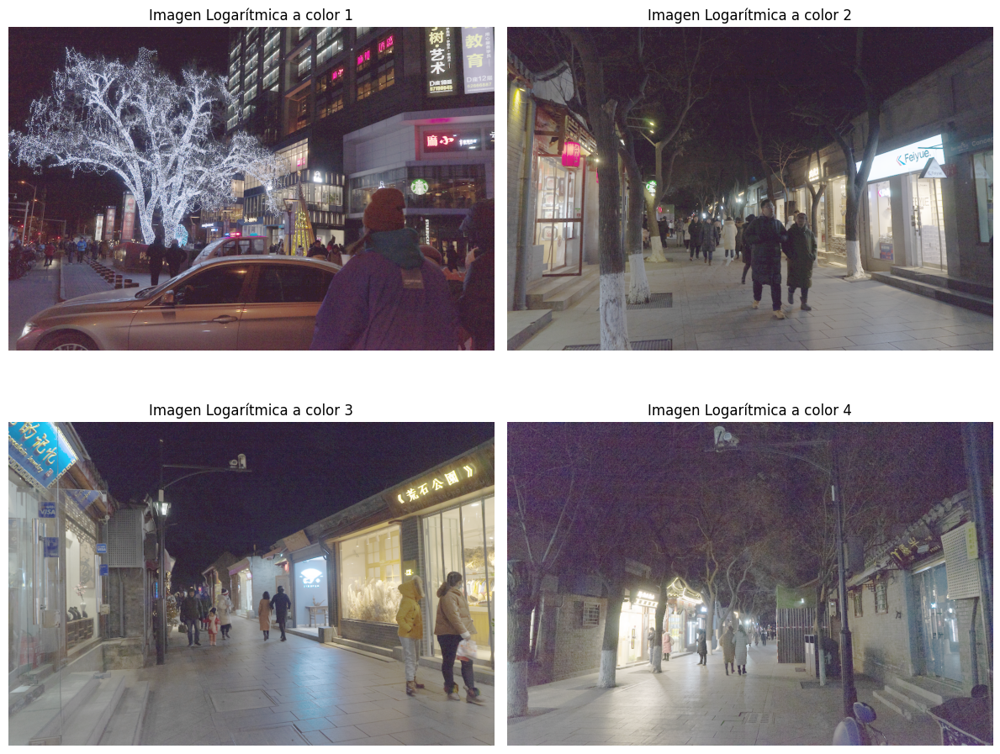

In [ ]:
# Transformación logarítmica para las 4 imágenes en escala de grises
log_images = []  # Lista para almacenar las imágenes transformadas logarítmicamente

for gray_img in images_rgb:  # Iterar sobre las imágenes en escala de grises
    img_normalizada = gray_img.astype(np.float32) + 1  # Añadir 1 para evitar log(0)

    # Parámetro para la escala de la transformación logarítmica
    c_log = 255 / np.log10(1 + 255)

    # Aplicar la transformación logarítmica
    imagen_logaritmica = c_log * np.log10(1 + img_normalizada)

    # Convertir la imagen de vuelta a formato uint8
    imagen_logaritmica = np.uint8(np.clip(imagen_logaritmica, 0, 255))

    log_images.append(imagen_logaritmica)  # Guardar la imagen transformada

# Mostrar las imágenes originales y logarítmicas en una cuadrícula 2x2
fig, axes = plt.subplots(2, 2, figsize=(12, 10))  # Crear una cuadrícula 2x2 para las imágenes

for i, (gray_img, imagen_logaritmica, ax) in enumerate(zip(gray_images, log_images, axes.flat)):
    # Mostrar la imagen original
    ax.imshow(imagen_logaritmica)  # Mostrar imagen logarítmica
    ax.set_title(f'Imagen Logarítmica a color {i+1}')
    ax.axis('off')  # Apagar los ejes

plt.tight_layout()
plt.show()

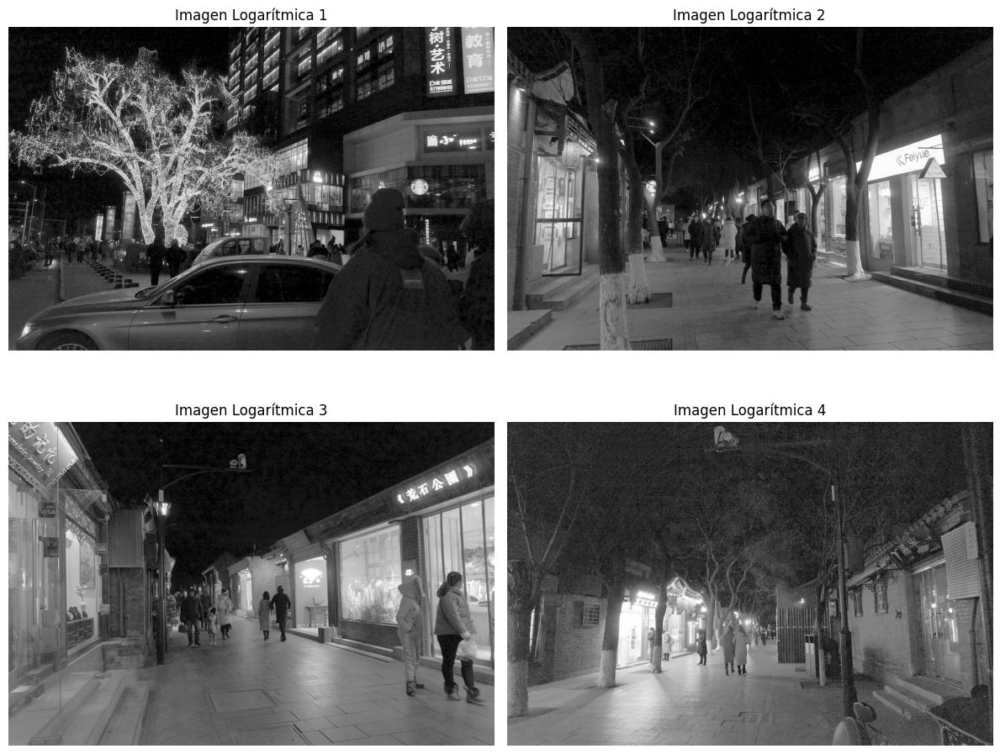

In [ ]:
# Transformación logarítmica para las 4 imágenes en escala de grises
log_images = []  # Lista para almacenar las imágenes transformadas logarítmicamente

for gray_img in gray_images:  # Iterar sobre las imágenes en escala de grises
    img_normalizada = gray_img.astype(np.float32) + 1  # Añadir 1 para evitar log(0)

    # Parámetro para la escala de la transformación logarítmica
    c_log = 255 / np.log10(1 + 255)

    # Aplicar la transformación logarítmica
    imagen_logaritmica = c_log * np.log10(1 + img_normalizada)

    # Convertir la imagen de vuelta a formato uint8
    imagen_logaritmica = np.uint8(np.clip(imagen_logaritmica, 0, 255))

    log_images.append(imagen_logaritmica)  # Guardar la imagen transformada

# Mostrar las imágenes originales y logarítmicas en una cuadrícula 2x2
fig, axes = plt.subplots(2, 2, figsize=(12, 10))  # Crear una cuadrícula 2x2 para las imágenes

for i, (gray_img, imagen_logaritmica, ax) in enumerate(zip(gray_images, log_images, axes.flat)):
    # Mostrar la imagen original
    ax.imshow(imagen_logaritmica, cmap='gray')  # Mostrar imagen logarítmica
    ax.set_title(f'Imagen Logarítmica {i+1}')
    ax.axis('off')  # Apagar los ejes

plt.tight_layout()
plt.show()

## Corrección Gamma

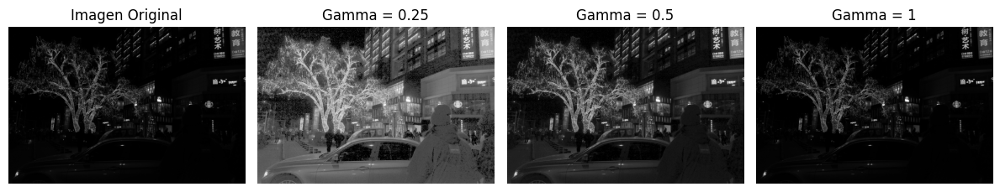

In [ ]:
# Lista de valores gamma
gamma_values = [0.25, 0.5, 1]

# Crear una figura para las imágenes
plt.figure(figsize=(12, 7))

# Agregar la imagen original como la primera
plt.subplot(2, 4, 1)
plt.title("Imagen Original")
plt.imshow(gray_images[0], cmap='gray')
plt.axis('off')

# Normalizar al rango [0, 1]
normalized_img = gray_images[0] / 255.0

# Generar y mostrar las imágenes transformadas
for i, gamma in enumerate(gamma_values, start=2):
    # Normalización y transformación gamma
    c = 255
    img_gamma = c*np.power(normalized_img, gamma) # Aplicar transformación gamma

    # Mostrar la imagen transformada
    plt.subplot(2, 4, i)
    plt.title(f"Gamma = {gamma}")
    plt.imshow(img_gamma, cmap='gray')
    plt.axis('off')

# Ajustar diseño y mostrar la cuadrícula
plt.tight_layout()
plt.show()


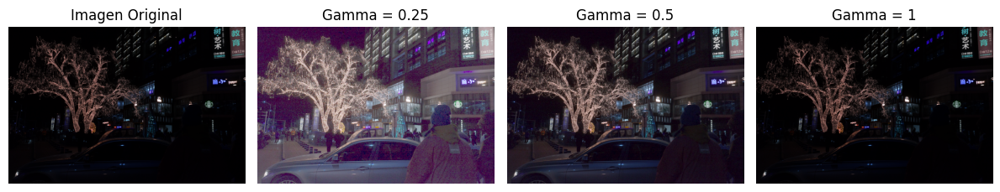

In [ ]:
# Lista de valores gamma
gamma_values = [0.25, 0.5, 1]

# Crear una figura para las imágenes
plt.figure(figsize=(12, 7))

# Agregar la imagen original como la primera
plt.subplot(2, 4, 1)
plt.title("Imagen Original")
plt.imshow(images[0])  # Mostrar imagen original a color
plt.axis('off')

# Normalizar la imagen a color al rango [0, 1]
normalized_img = images[0] / 255.0

# Separar los canales R, G, B
r, g, b = normalized_img[:, :, 0], normalized_img[:, :, 1], normalized_img[:, :, 2]

# Generar y mostrar las imágenes transformadas
for i, gamma in enumerate(gamma_values, start=2):
    # Aplicar la transformación gamma a cada canal
    r_gamma = np.clip(255 * (r ** gamma), 0, 255)
    g_gamma = np.clip(255 * (g ** gamma), 0, 255)
    b_gamma = np.clip(255 * (b ** gamma), 0, 255)

    # Combinar los canales transformados
    img_gamma = np.stack([r_gamma, g_gamma, b_gamma], axis=-1)

    # Mostrar la imagen transformada
    plt.subplot(2, 4, i)
    plt.title(f"Gamma = {gamma}")
    plt.imshow(img_gamma.astype(np.uint8))  # Asegúrate de convertir a uint8 para la visualización
    plt.axis('off')

# Ajustar diseño y mostrar la cuadrícula
plt.tight_layout()
plt.show()


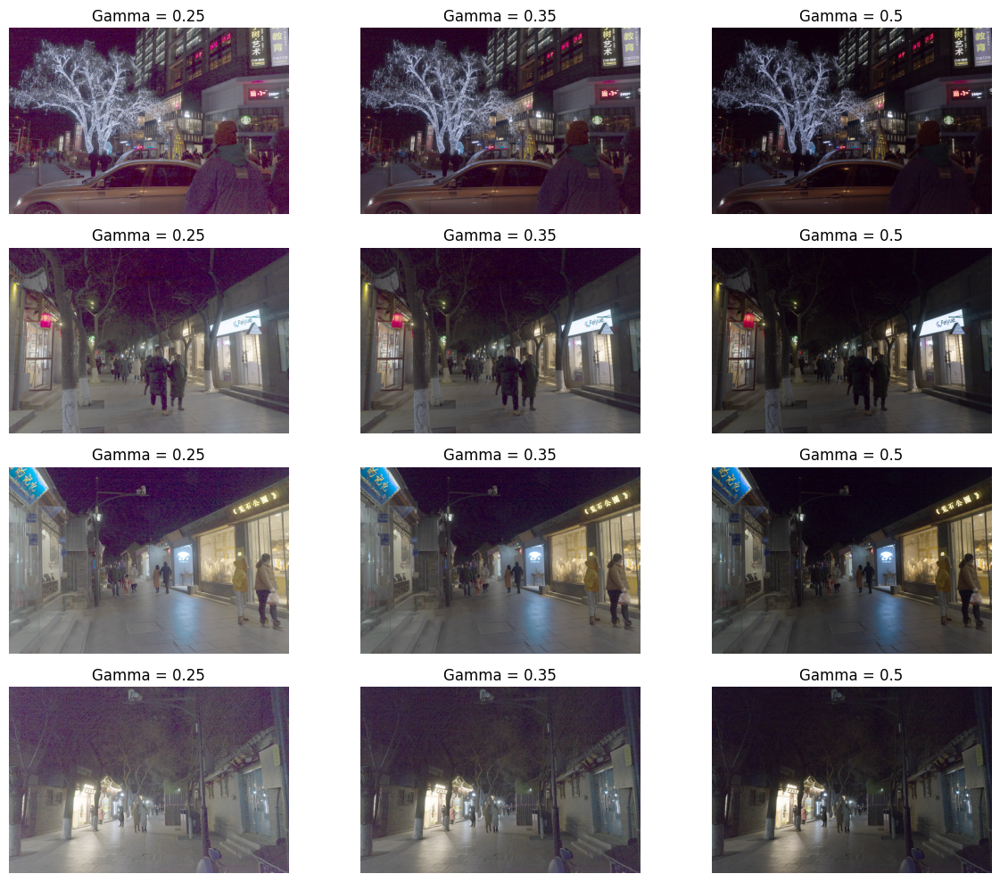

In [ ]:
# Lista de valores gamma
gamma_values = [0.25, 0.35, 0.5]

# Crear una figura para las imágenes
plt.figure(figsize=(16, 10))  # Aumentamos el tamaño de la figura para mejor visualización

# Procesar cada imagen en la lista de imágenes
for idx, img in enumerate(images_rgb):
    # Mostrar la imagen original en la cuadrícula
    #plt.subplot(4, 4, idx * (len(gamma_values) + 1) + 1)  # Ajustamos la posición para cada imagen original
    #plt.title(f"Imagen Original {idx + 1}")
    #plt.imshow(img)  # Mostrar imagen original a color
    #plt.axis('off')

    # Normalizar la imagen a color al rango [0, 1]
    normalized_img = img / 255.0

    # Separar los canales R, G, B
    r, g, b = normalized_img[:, :, 0], normalized_img[:, :, 1], normalized_img[:, :, 2]

    # Generar y mostrar las imágenes transformadas con diferentes valores de gamma
    for i, gamma in enumerate(gamma_values, start=2):
        # Aplicar la transformación gamma a cada canal
        r_gamma = np.clip(255 * (r ** gamma), 0, 255)
        g_gamma = np.clip(255 * (g ** gamma), 0, 255)
        b_gamma = np.clip(255 * (b ** gamma), 0, 255)

        # Combinar los canales transformados
        img_gamma = np.stack([r_gamma, g_gamma, b_gamma], axis=-1)

        # Mostrar la imagen transformada
        plt.subplot(4, 4, idx * (len(gamma_values) + 1) + i)
        plt.title(f"Gamma = {gamma}")
        plt.imshow(img_gamma.astype(np.uint8))  # Asegúrate de convertir a uint8 para la visualización
        plt.axis('off')

# Ajustar diseño y mostrar la cuadrícula
plt.tight_layout()
plt.show()


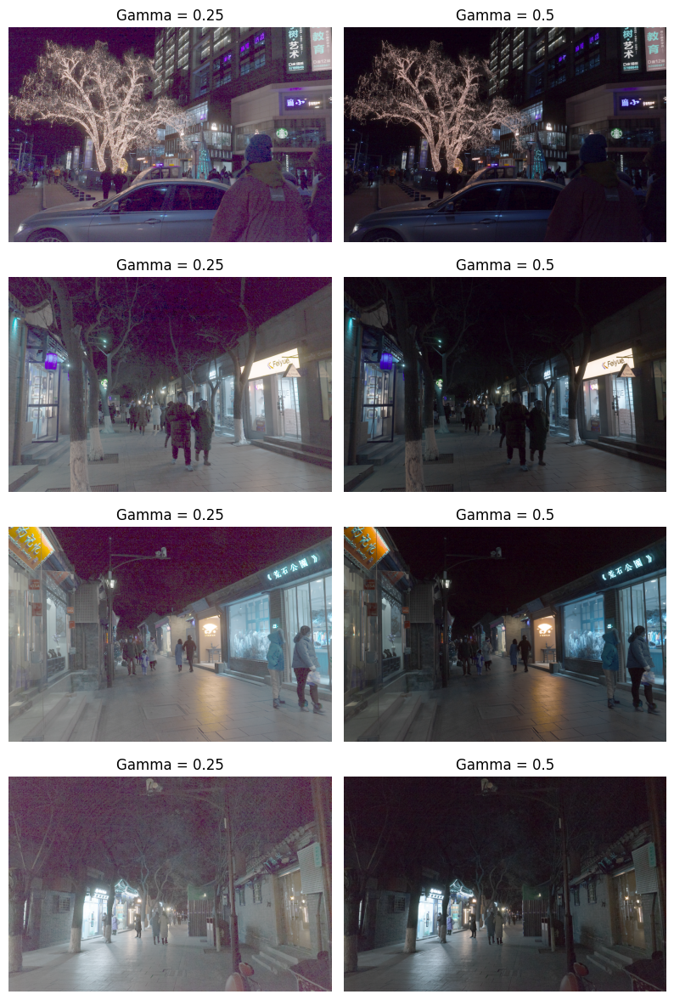

In [ ]:
# Lista de valores gamma
gamma_values = [0.25, 0.5]

# Crear una figura para las imágenes
plt.figure(figsize=(12, 12))  # Ajustar el tamaño para 4 imágenes (dos a dos)

# Procesar cada imagen en la lista de imágenes
for idx, img in enumerate(images[:4]):  # Tomar las primeras 4 imágenes
    # Normalizar la imagen al rango [0, 1]
    normalized_img = img / 255.0

    # Separar los canales R, G, B
    r, g, b = normalized_img[:, :, 0], normalized_img[:, :, 1], normalized_img[:, :, 2]

    # Generar y mostrar las imágenes transformadas con diferentes valores de gamma
    for i, gamma in enumerate(gamma_values):
        # Aplicar la transformación gamma a cada canal
        r_gamma = np.clip(255 * (r ** gamma), 0, 255)
        g_gamma = np.clip(255 * (g ** gamma), 0, 255)
        b_gamma = np.clip(255 * (b ** gamma), 0, 255)

        # Combinar los canales transformados
        img_gamma = np.stack([r_gamma, g_gamma, b_gamma], axis=-1)

        # Mostrar la imagen transformada
        plt.subplot(4, 3, idx * 3 + i + 2)  # Ajustar la posición en la cuadrícula
        plt.title(f"Gamma = {gamma}")
        plt.imshow(img_gamma.astype(np.uint8))
        plt.axis('off')

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()
plt.show()


### CLAHE (Contrast Limited Adaptive Histogram Equalization) y Ecualización del Histograma
[CLAHE OpenCV](https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html)

- Divide la imagen en pequeñas regiones llamadas "tiles" y aplica equalización del histograma de forma local.

- Mejora el contraste localmente sin sobrecargarlo globalmente.

- Puede crear efectos de bloques o mosaicos si las transiciones entre tiles no están bien suavizadas.

*Estos métodos pueden combinarse dependiendo de la naturaleza de la imagen. Por ejemplo, combinar CLAHE con corrección gamma suele dar buenos resultados para imágenes nocturnas.*

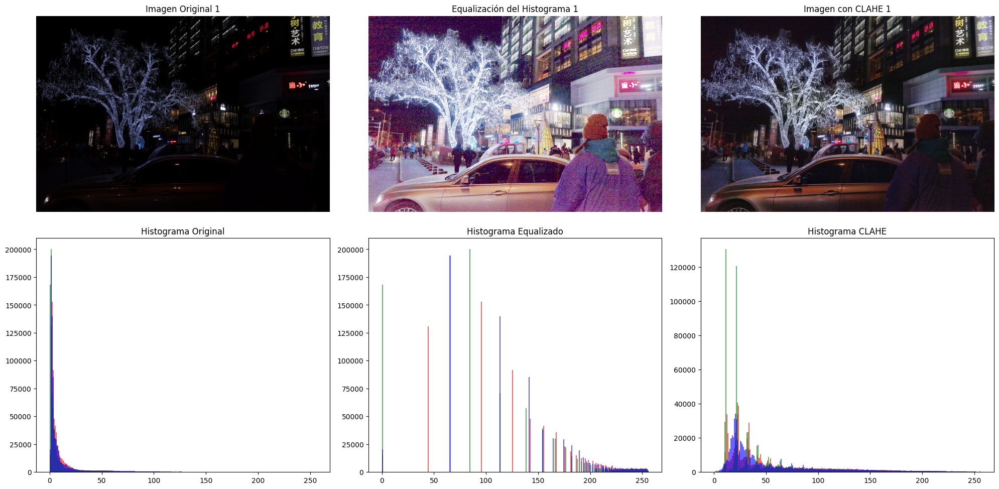

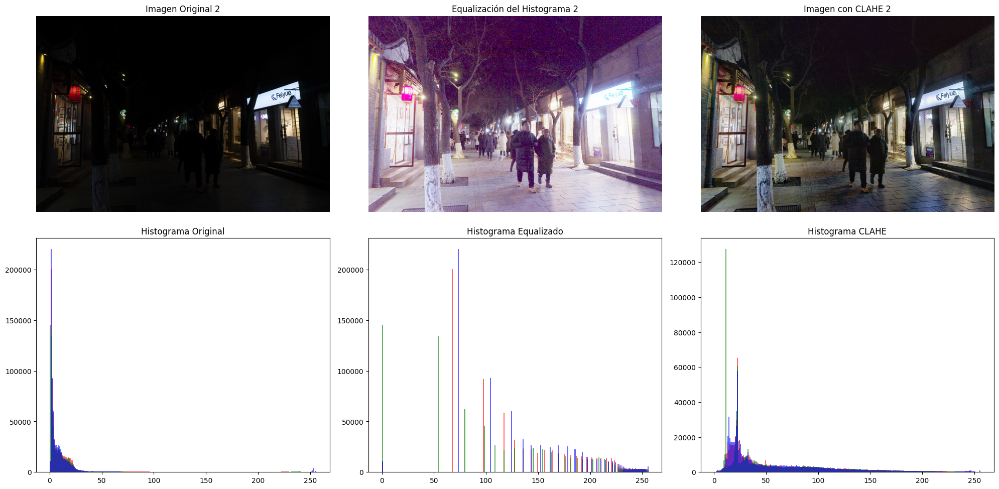

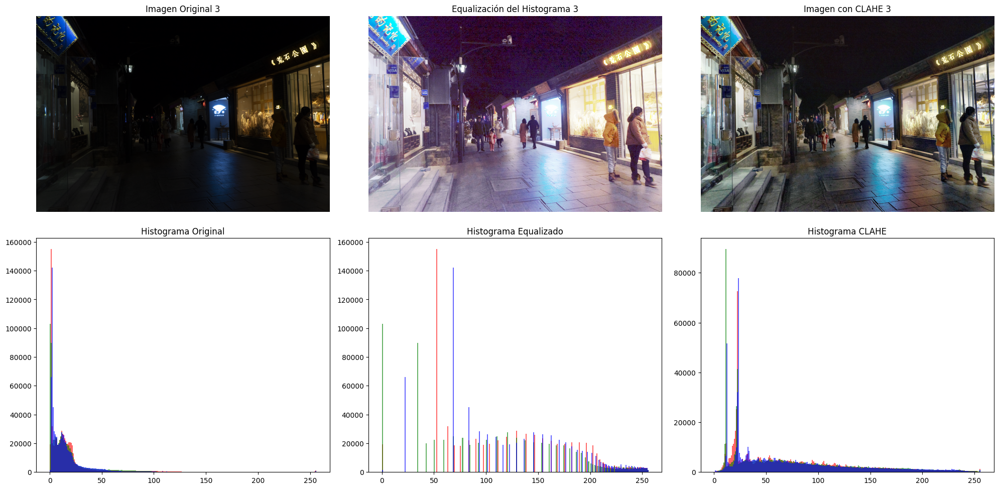

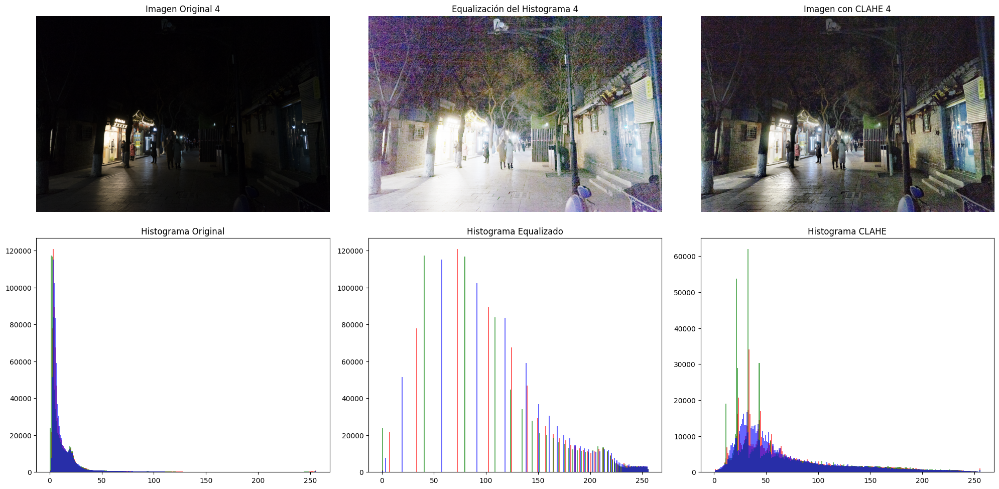

In [ ]:
# Supongamos que 'images' contiene las 4 imágenes a color.
# Usaremos la primera imagen como ejemplo, pero puedes adaptar esto para las 4 imágenes.

for idx, img in enumerate(images_rgb):  # Procesar cada imagen en la lista de imágenes
    # Convertir la imagen a espacio de color HSV (si prefieres trabajar en RGB, puedes omitir esto)
    img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

    # 1. Equalización del histograma para cada canal
    img_eq = np.copy(img)
    for i in range(3):  # Para cada canal (R, G, B)
        img_eq[:, :, i] = cv2.equalizeHist(img[:, :, i])

    # 2. Crear un objeto CLAHE y aplicar a cada canal (R, G, B)
    clahe = cv2.createCLAHE(clipLimit=10.0, tileGridSize=(8, 8))
    img_clahe = np.copy(img)
    for i in range(3):  # Para cada canal (R, G, B)
        img_clahe[:, :, i] = clahe.apply(img[:, :, i])

    # Mostrar imágenes y sus histogramas
    fig, axes = plt.subplots(2, 3, figsize=(20, 10))

    # Imagen original
    axes[0, 0].imshow(img)
    axes[0, 0].set_title(f"Imagen Original {idx + 1}")
    axes[0, 0].axis('off')
    axes[1, 0].hist(img[..., 0].ravel(), bins=256, range=(0, 256), color='red', alpha=0.6)  # Histograma canal R
    axes[1, 0].hist(img[..., 1].ravel(), bins=256, range=(0, 256), color='green', alpha=0.6)  # Histograma canal G
    axes[1, 0].hist(img[..., 2].ravel(), bins=256, range=(0, 256), color='blue', alpha=0.6)  # Histograma canal B
    axes[1, 0].set_title("Histograma Original")

    # Imagen con equalización del histograma
    axes[0, 1].imshow(img_eq)
    axes[0, 1].set_title(f"Equalización del Histograma {idx + 1}")
    axes[0, 1].axis('off')
    axes[1, 1].hist(img_eq[..., 0].ravel(), bins=256, range=(0, 256), color='red', alpha=0.6)  # Histograma canal R
    axes[1, 1].hist(img_eq[..., 1].ravel(), bins=256, range=(0, 256), color='green', alpha=0.6)  # Histograma canal G
    axes[1, 1].hist(img_eq[..., 2].ravel(), bins=256, range=(0, 256), color='blue', alpha=0.6)  # Histograma canal B
    axes[1, 1].set_title("Histograma Equalizado")

    # Imagen con CLAHE
    axes[0, 2].imshow(img_clahe)
    axes[0, 2].set_title(f"Imagen con CLAHE {idx + 1}")
    axes[0, 2].axis('off')
    axes[1, 2].hist(img_clahe[..., 0].ravel(), bins=256, range=(0, 256), color='red', alpha=0.6)  # Histograma canal R
    axes[1, 2].hist(img_clahe[..., 1].ravel(), bins=256, range=(0, 256), color='green', alpha=0.6)  # Histograma canal G
    axes[1, 2].hist(img_clahe[..., 2].ravel(), bins=256, range=(0, 256), color='blue', alpha=0.6)  # Histograma canal B
    axes[1, 2].set_title("Histograma CLAHE")

    # Ajustar diseño y mostrar la cuadrícula
    plt.tight_layout()
    plt.show()


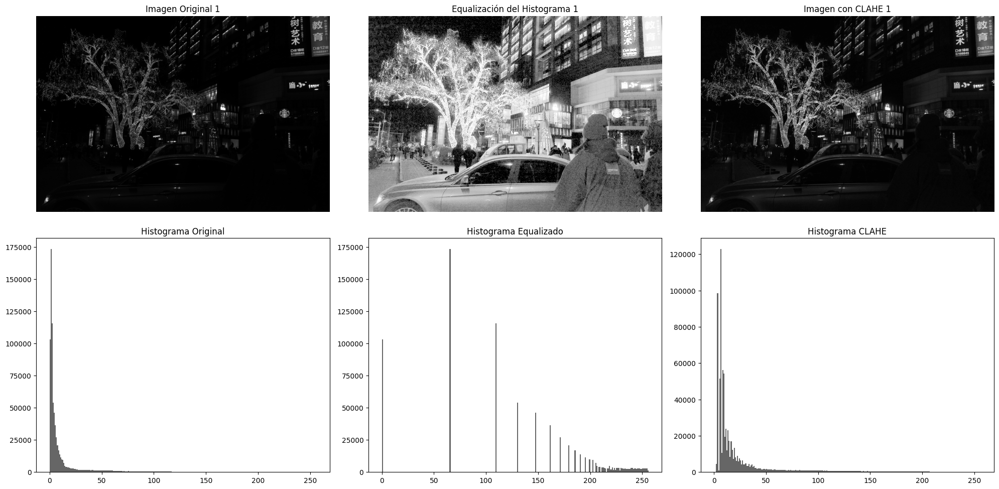

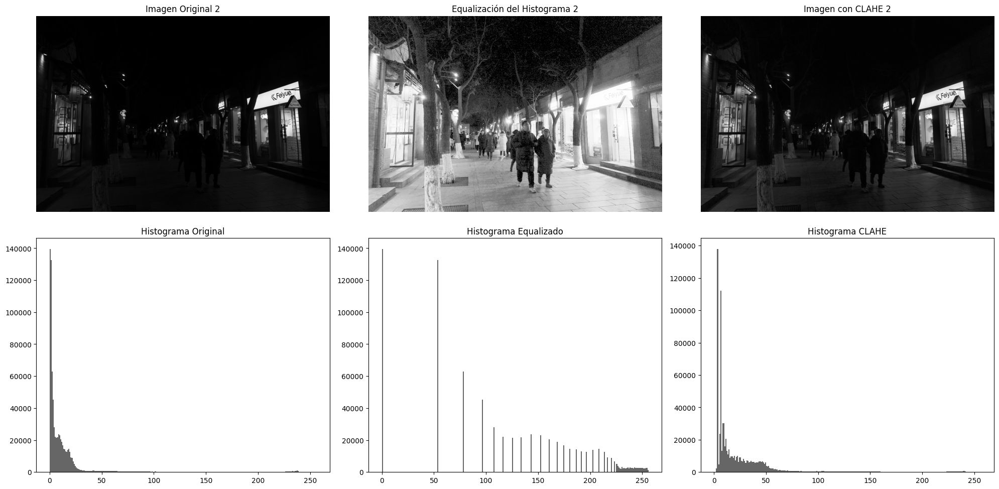

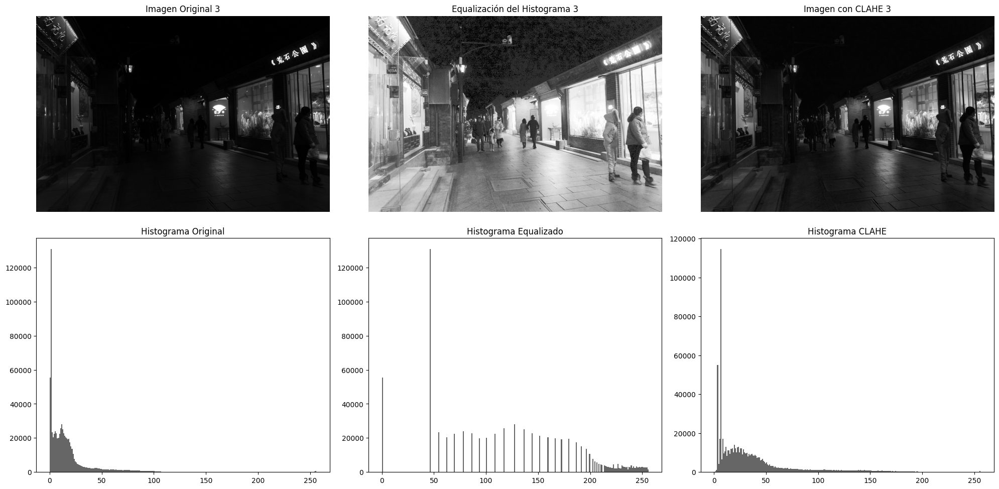

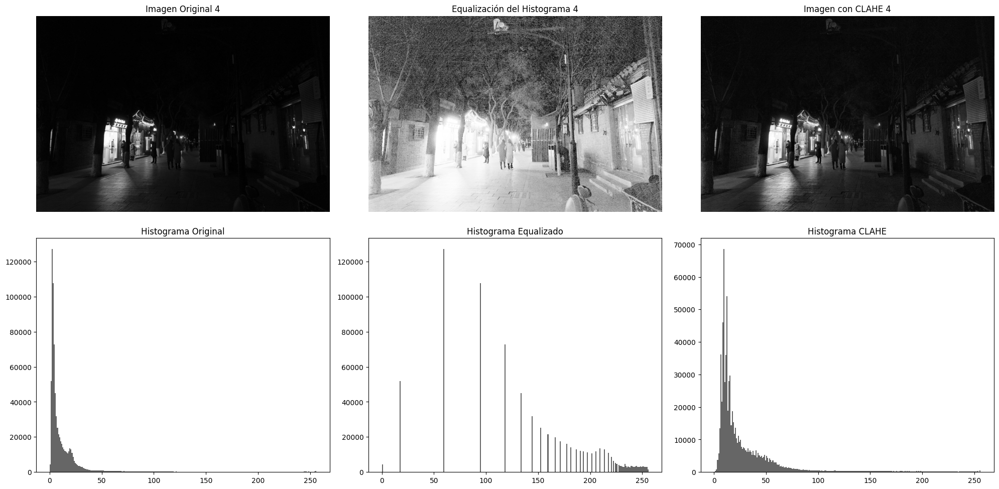

In [ ]:
# Supongamos que 'images' contiene las 4 imágenes en escala de grises.
# Usaremos la primera imagen como ejemplo, pero puedes adaptar esto para las 4 imágenes.

for idx, img in enumerate(gray_images):  # Procesar cada imagen en la lista de imágenes
    # 1. Equalización del histograma
    img_eq = cv2.equalizeHist(img)

    # 2. Crear un objeto CLAHE y aplicar
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img)

    # Mostrar imágenes y sus histogramas
    fig, axes = plt.subplots(2, 3, figsize=(20, 10))

    # Imagen original
    axes[0, 0].imshow(img, cmap='gray')
    axes[0, 0].set_title(f"Imagen Original {idx + 1}")
    axes[0, 0].axis('off')
    axes[1, 0].hist(img.ravel(), bins=256, range=(0, 256), color='black', alpha=0.6)  # Histograma de la imagen original
    axes[1, 0].set_title("Histograma Original")

    # Imagen con equalización del histograma
    axes[0, 1].imshow(img_eq, cmap='gray')
    axes[0, 1].set_title(f"Equalización del Histograma {idx + 1}")
    axes[0, 1].axis('off')
    axes[1, 1].hist(img_eq.ravel(), bins=256, range=(0, 256), color='black', alpha=0.6)  # Histograma de la imagen equalizada
    axes[1, 1].set_title("Histograma Equalizado")

    # Imagen con CLAHE
    axes[0, 2].imshow(img_clahe, cmap='gray')
    axes[0, 2].set_title(f"Imagen con CLAHE {idx + 1}")
    axes[0, 2].axis('off')
    axes[1, 2].hist(img_clahe.ravel(), bins=256, range=(0, 256), color='black', alpha=0.6)  # Histograma de la imagen con CLAHE
    axes[1, 2].set_title("Histograma CLAHE")

    # Ajustar diseño y mostrar la cuadrícula
    plt.tight_layout()
    plt.show()


### Multiplicación
- Podemos modificar el brillo aplicando un factor de escala a toda la imagen
- Recuerda que al aplicar un factor de escala hay pixeles que pueden superar el umbral!
- Ej: un pixel con intensidad 254 con una escala de 2 pasará a valer 508. Se puede optar por recorte de valores entre 0 y 255 (8bits) o normalizar

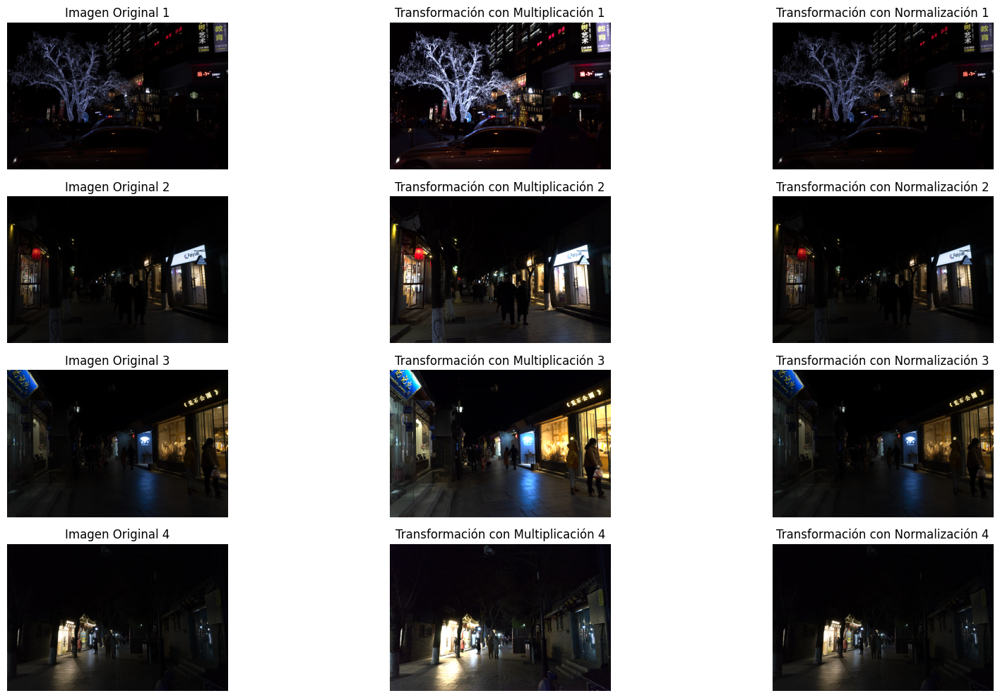

In [ ]:
# Definir el factor de escala
factor = 2.7  # Cambia este valor para aumentar o disminuir el brillo (Ejemplo: 0.8 para reducir)

plt.figure(figsize=(18, 10))  # Aseguramos que la figura tenga suficiente espacio para mostrar todo

for idx, image in enumerate(images_rgb):  # Procesar cada imagen en la lista
    # Verificar si la imagen es en escala de grises (es decir, solo tiene un canal)
    is_grayscale = len(image.shape) == 2


    # 1. Transformación con recorte (np.clip)
    if is_grayscale:
        image_clipped = np.clip(image * factor, 0, 255).astype(np.uint8)
    else:
        image_clipped = np.clip(image * factor, 0, 255).astype(np.uint8)
    # 2. Transformación con normalización
    if is_grayscale:
        normalized = ((image * factor - np.min(image * factor)) / (np.max(image * factor) - np.min(image * factor)) * 255).astype(np.uint8)
    else:
        normalized = ((image * factor - np.min(image * factor)) / (np.max(image * factor) - np.min(image * factor)) * 255).astype(np.uint8)
    # Mostrar las imágenes lado a lado
    plt.subplot(4, 3, idx * 3 + 1)
    plt.title(f"Imagen Original {idx + 1}")
    plt.imshow(image)
    plt.axis("off")

    plt.subplot(4, 3, idx * 3 + 2)
    plt.title(f"Transformación con Multiplicación {idx + 1}")
    plt.imshow(image_clipped)
    plt.axis("off")

    plt.subplot(4, 3, idx * 3 + 3)
    plt.title(f"Transformación con Normalización {idx + 1}")
    plt.imshow(normalized)
    plt.axis("off")

# Ajustar el diseño para mostrar las imágenes correctamente
plt.tight_layout()
plt.show()